In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../../shared_code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from inverse_tasks_func import synthesis
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

In [2]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

In [3]:
compute_UNet_RF(num_enc_conv=[2,2,2,2],  num_mid_conv=3, kernel_size=3)

172

# functions 

In [4]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic


In [5]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
similarity_vactor = lambda data, v : (v/(v.norm(dim = 1, keepdim=True)+1e-6) @(data/(data.norm(dim = 1, keepdim=True) +1e-6 ) ).T).flatten()
similarity_matrix_2mats = lambda data1, data2 : data1/data1.norm(dim = 1, keepdim=True) @(data2/data2.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


# Load denoisers 

In [6]:
denoisers = {}

root_path = '/mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/'

paths = { 
        'mixture-color-deep-no-skip-full':'UNet_flex/imagenet/0to255_RF_84x84_set_size_1281167_color_no_skip_deep_dec_full_64x64/',    

         'mixture-color-deep-no-skip-2blocks':'UNet_flex/imagenet/0to255_RF_76x76_set_size_1281167_color_no_skip_deep_dec_2blocks_64x64/',    
         'mixture-color-deep-no-skip-2blocks-lighter':'UNet_flex/imagenet/0to255_RF_64x64_set_size_1281167_color_no_skip_deep_dec_2blocks_lighter_64x64/',
    
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip-full
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 4096
num_epochs 2000
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 1281167
imagenet_subset_ids None
data_name imagenet
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/UNet_flex/imagenet/0to255_RF_84x84_set_size_1281167_color_no_skip_deep_dec_full_64x64
optional_dir_label color_no_skip_deep_dec_full
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 512]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
upsample_with_bias False
data_path /mnt/home/zkadkhodaie/ceph/datasets/imagenet
******************************************************
number 

In [7]:
denoisers.keys()


dict_keys(['mixture-color-deep-no-skip-full', 'mixture-color-deep-no-skip-2blocks', 'mixture-color-deep-no-skip-2blocks-lighter'])

In [8]:
layers = {}
for group in groups:
    layers[group] = []
    for i in range(len(denoisers[group].encoder)):
        layers[group].append(denoisers[group].encoder[str(i) ][0].weight.shape[0])
    
    layers[group].append(denoisers[group].mid[0].weight.shape[0])
    
    for i in range(len(denoisers[group].decoder)-1 , 0, -1):
        layers[group].append(denoisers[group].decoder[str(i) ][0].weight.shape[0])


layers

{'mixture-color-deep-no-skip-full': [64, 128, 256, 512, 256, 128],
 'mixture-color-deep-no-skip-2blocks': [128, 256, 512, 256],
 'mixture-color-deep-no-skip-2blocks-lighter': [64, 128, 512, 128]}

In [9]:
block_names = {}
for group in groups: 
    block_names[group] = []
    for l in range(int(len(layers[group])/2)): 
        block_names[group].append('enc' + str(l))
    block_names[group].append('mid'  )        
    for l in range(int(len(layers[group])/2)-1, 0,-1):
        block_names[group].append('dec' + str(l) )
block_names   

{'mixture-color-deep-no-skip-full': ['enc0',
  'enc1',
  'enc2',
  'mid',
  'dec2',
  'dec1'],
 'mixture-color-deep-no-skip-2blocks': ['enc0', 'enc1', 'mid', 'dec1'],
 'mixture-color-deep-no-skip-2blocks-lighter': ['enc0', 'enc1', 'mid', 'dec1']}

# Load datasets 

In [10]:
time0 = time.time()
test_sets = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/imagenet/validation_color_full_64x64_list.pt', weights_only=True) 
print(f"loading time: {time.time() - time0} seconds ")

loading time: 3.5694758892059326 seconds 


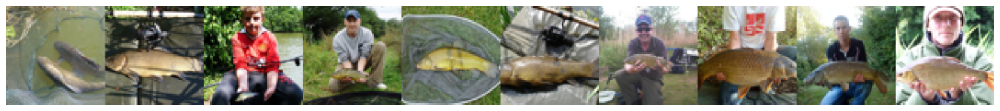

In [11]:
show_im_grid(test_sets[0][0:10] )


In [12]:
print('number of images in each class:', test_sets[0].shape)
K = test_sets[0].shape[2]
n_channels = test_sets[0].shape[1]
print(len(test_sets))

number of images in each class: torch.Size([50, 3, 64, 64])
1000


tensor(0.4424)


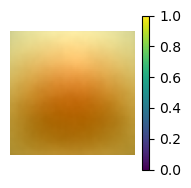

In [13]:
dist_mean = torch.concatenate(test_sets).mean(dim = (0))
plot_single_im(dist_mean, colorbar=True)
print(dist_mean.mean())

In [14]:
dist_mean.mean(dim = (1,2), keepdim = True)

tensor([[[0.4764]],

        [[0.4504]],

        [[0.4005]]])

In [15]:
test_sets_cat = torch.concatenate(test_sets)
test_sets_cat.shape

torch.Size([50000, 3, 64, 64])

In [16]:
# a_bars = torch.load('../results/phis_noise_ave_all_scales_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only=True)
a_bars = {}
for group in groups: 
    
    a_bars[group] = torch.load('../results/a_bar_noise_ave_validation_full_'+group+'_imagenet64x64.pt', weights_only = True)
    print(group)

        


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-2blocks
mixture-color-deep-no-skip-2blocks-lighter


In [17]:
sigmas = list(a_bars[group].keys())
if sigmas[-1] < sigmas[0]:
    sigmas.reverse()
sigmas

[0, 10, 50, 150, 255]

In [18]:
# phis = torch.load('../results/phis_noise_ave_64x64_mixture-color-no-skip-deep_imagenet.pt', weights_only = True)


phis = {}
for group in groups:
    phis[group] ={}
    for sig in a_bars[group].keys():
        mid = int(len(layers[group])/2)
        phis[group][sig] = [a_bars[group][sig][i][:, sum(layers[group][0:mid]): sum(layers[group][0:mid+1]) ] for i in range(len(a_bars[group][sig]))]
    

In [19]:
# ch_selectivity=torch.cat(phis[group][sig]).norm(1, dim = 0).cpu()**2 / torch.cat(phis[group][sig]).norm(2, dim = 0).cpu()**2/torch.cat(phis[group][sig]).shape[0]
ch_selectivity = {}
ids_selectivity_sorted = {}
for group in groups:
    ch_selectivity[group] = {}
    ids_selectivity_sorted[group] = {}
    for sig in sigmas:
        
        ch_selectivity[group][sig] = participation_ratio_dataset(torch.cat(phis[group][sig]).T.cpu())
        ch_selectivity[group][sig]= torch.nan_to_num(ch_selectivity[group][sig], nan=0.0)
        ids_selectivity_sorted[group][sig] = ch_selectivity[group][sig].sort(descending =True)[1]
        


# Compare denoising performance 

In [20]:
## compute psnr 

my_ims = torch.cat([test_sets[i][0:1] for i in range(len(test_sets)) ])

sig_range = torch.logspace(.0001,4,15)

psnr_test = {}
# psnr_train = {}
for group in groups: 

    ## train 
    print(group)
    if 'gray' in group.split('-'): 
        loader = DataLoader(dataset=my_ims.mean(dim =1, keepdim=True), batch_size=512, shuffle=False)
    else: 
        loader = DataLoader(dataset=my_ims, batch_size=512, shuffle=False)
            
    try: 
        psnr_test[group] = calc_psnr(denoisers[group],loader,sig_range, device, skip=False)
    except KeyError: 
        pass


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-2blocks
mixture-color-deep-no-skip-2blocks-lighter


mixture-color-deep-no-skip-full
mixture-color-deep-no-skip-2blocks
mixture-color-deep-no-skip-2blocks-lighter


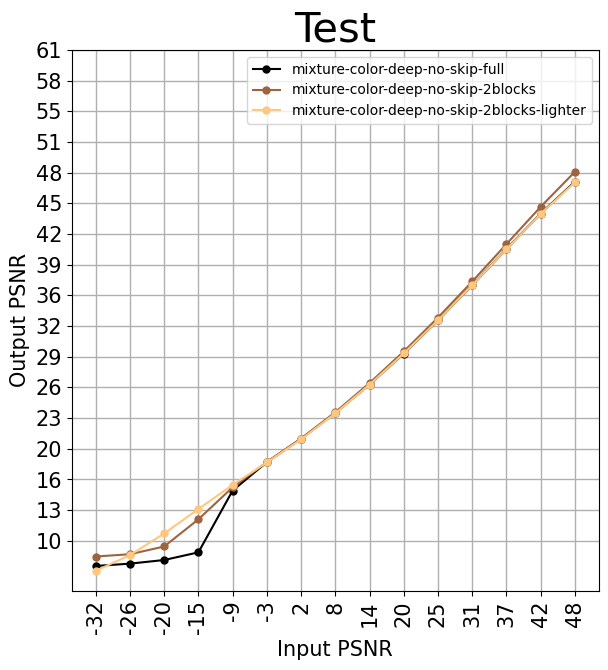

In [21]:
## plot 
f , axs = plt.subplots(1,1, figsize=(6,6), sharex = True, sharey=True)
plt.tight_layout()
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[group].keys()]

for group in groups: 
    print(group)
    if 'color' in group.split('-'):
        ## test 
        axs.plot(x_axis, [psnr_test[group][key] for key in psnr_test[group].keys()], 
                    marker = '.',markersize = 10,label =  group , alpha = 1)

axs.set_xticks(x_axis);
axs.grid(  linewidth=1);
axs.set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=15)
# axs.set_xlim(-3, 45)

y_axis = np.linspace(10,61,17) 
axs.set_yticks(y_axis);
axs.set_yticklabels(np.round(y_axis).astype(int) , fontsize=15);
# axs.set_ylim(18, 45)


colormap = plt.cm.copper #nipy_spectral, Set1,Paired   
plot_colors = [colormap(i) for i in np.linspace(0, 1, len(groups) )]
for k,j in enumerate(axs.lines):
    j.set_color(plot_colors[k])
# axs.plot(x_axis, [ -10*np.log10( (std/255)**2  ) for std in sig_range/K ],linestyle = 'dotted', label = 
            # 'expected from 1d manifold(N=1)', color='gray')
# axs.plot( [0,48],[0,48] ,'k--', alpha = .7, label = 'identity');
axs.legend(fontsize = 10);
axs.set_title('Test', fontsize = 30)
axs.set_xlabel('Input PSNR', fontsize = 15)
axs.set_ylabel('Output PSNR', fontsize = 15);


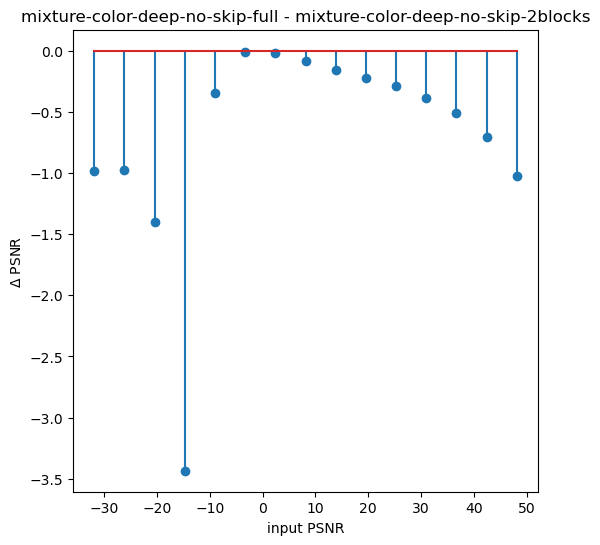

In [22]:
denoiser1 =  'mixture-color-deep-no-skip-full'
denoiser2 = 'mixture-color-deep-no-skip-2blocks'
f , axs = plt.subplots(1,1, figsize=(6,6), sharex = True, sharey=True)

axs.stem(x_axis,[psnr_test[denoiser1][key] - psnr_test[denoiser2][key] for key in psnr_test[group].keys()])
axs.set_xlabel('input PSNR')
axs.set_title(denoiser1+ ' - '+ denoiser2)
axs.set_ylabel('$\Delta$ PSNR');


## Always off channels 

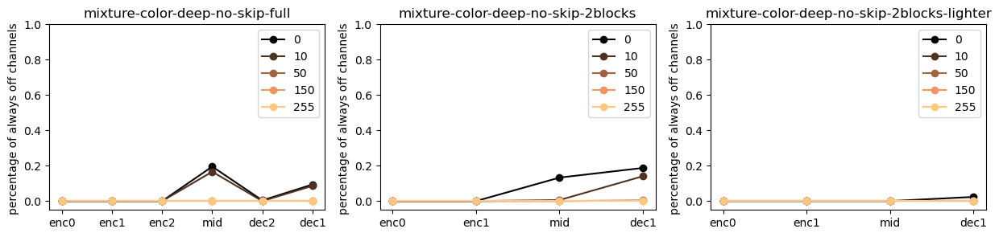

In [39]:
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) )

j = 0
for group in groups:
    off_channels = {}
    for sig in sigmas:
        off_channels[sig] = []
        k1 = 0
        for l in layers[group]: 
            phi_block = torch.cat(a_bars[group][sig])[:,k1:k1 + l]
            off_channels[sig].append((phi_block.sum(dim = 0) == 0).sum().item())
            k1 += l  
            
    plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(sigmas ))]
    
    c = 0
    for sig in sigmas:    
        axs[j].plot(block_names[group], torch.tensor(off_channels[sig])/torch.tensor(layers[group]), '-o', color = plot_colors[c],  label = sig)
        c+= 1
    axs[j].set_ylabel('percentage of always off channels ');
    axs[j].set_ylim(-.05,1)
    axs[j].legend();
    axs[j].set_title(group);
    j += 1

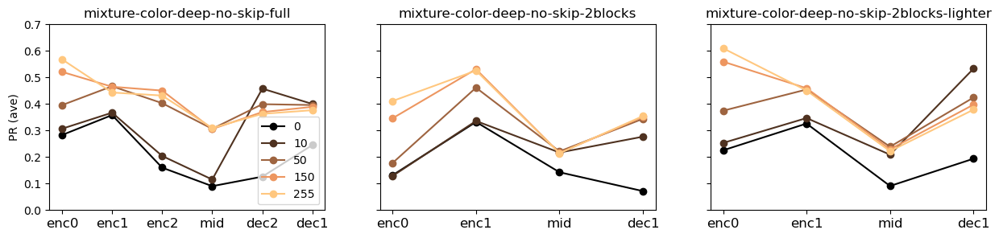

In [44]:
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, len(a_bars[group ].keys()))]
f, axs = plt.subplots(1, len(groups), figsize = ( len(groups)*5, 3) , sharey=True)

j = 0
for group in groups:
    c = 0
    for sig in sigmas:
        phi_gaus = get_activation_means_unconditional(denoisers[group], Gaussian_samples* sig/255     ) 
            
        all_participation_ratio_mean = []
        for b in range(len(phi_gaus)): 
            all_participation_ratio_mean.append(participation_ratio_dataset(phi_gaus[b]).mean().cpu())        

        
        axs[j].plot(block_names[group], all_participation_ratio_mean, '-o', color = plot_colors[c],  label = sig)
        axs[j].set_title(group)
        axs[j].set_ylim(0,.7)
        c+= 1
    j +=1
axs[0].set_ylabel('PR (ave)');
axs[0].legend();

sparser than image distribution 

# Synthesis

In [40]:

n_samples =30

seed = 1
freq =100
sig_L = .02
h0= .01
beta = .02

fixed_h =True
all_samples = {}
all_interm_Ys = {}
all_init = []
skip = True
start_time_total = time.time()

for group in groups: 
    if 'skip' in group.split('-'): 
        skip = False
    if seed is not None:
        torch.manual_seed(seed )
        

    
    print('--------- group : ', group)        
    all_samples[group] = {}
    all_interm_Ys[group] = {}            
    temp = []
    for i in range(1):    
        if 'color' in group.split('-'): 
            n_channels = 3
            init_im = torch.ones((n_samples,n_channels ,K,K) ,device = device )*.45+ torch.randn(n_samples,n_channels ,K,K, device = device)*3
            
        else: 
            n_channels = 1        
            init_im = dist_mean.mean(dim=0,keepdim=True).to(device)+ torch.randn(n_samples,n_channels ,K,K, device = device) * 3

        
        sample, interm_Ys,sigs,means, ts = batch_synthesis(denoisers[group],
                                              init_im=init_im, 
                                              # sig_0=1, 
                                              sig_L=sig_L, 
                                              h0=h0, 
                                              beta=beta, 
                                              freq=freq,
                                              device=device, 
                                              fixed_h = fixed_h,
                                              max_T=20000, 
                                              seed= seed , 
                                              skip = skip
                                              )
                    
        temp.append(sample.detach())    
    
    all_samples[group] = torch.cat(temp)
    all_interm_Ys[group] = interm_Ys
    
            
print("--- %s seconds ---" % (time.time() - start_time_total))

--------- group :  mixture-color-deep-no-skip-full
----------------------------- 100
sigma  2.4480087757110596
mean  0.4455631673336029
----------------------------- 200
sigma  2.372196674346924
mean  0.4290953278541565
----------------------------- 300
sigma  2.3033764362335205
mean  0.41510009765625
----------------------------- 400
sigma  2.2452938556671143
mean  0.403446763753891
----------------------------- 500
sigma  2.1722025871276855
mean  0.3977765440940857
----------------------------- 600
sigma  2.1052255630493164
mean  0.3821863830089569
----------------------------- 700
sigma  2.0524094104766846
mean  0.36866259574890137
----------------------------- 800
sigma  1.992592692375183
mean  0.3571177124977112
----------------------------- 900
sigma  1.9353877305984497
mean  0.3515130877494812
----------------------------- 1000
sigma  1.8801532983779907
mean  0.34286126494407654
----------------------------- 1100
sigma  1.8277674913406372
mean  0.33996978402137756
--------------

fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.02  seed= 1


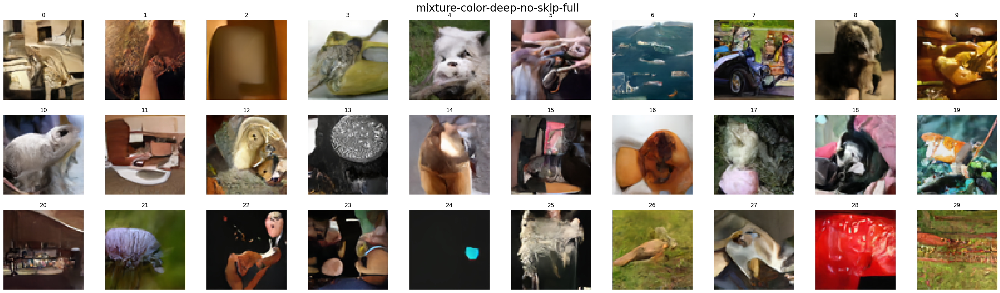

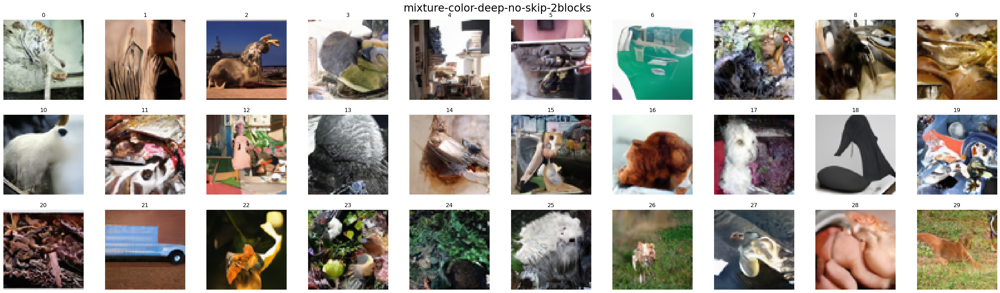

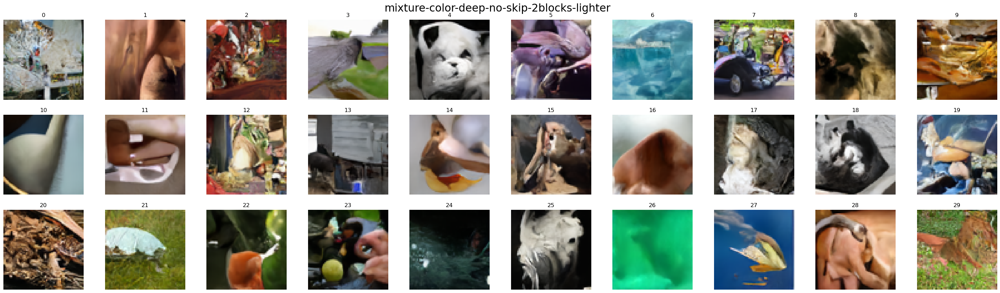

In [41]:
print('fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in groups: 
    show_im_set(all_samples[group], n_columns=10, label=group)

fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.05  seed= 1


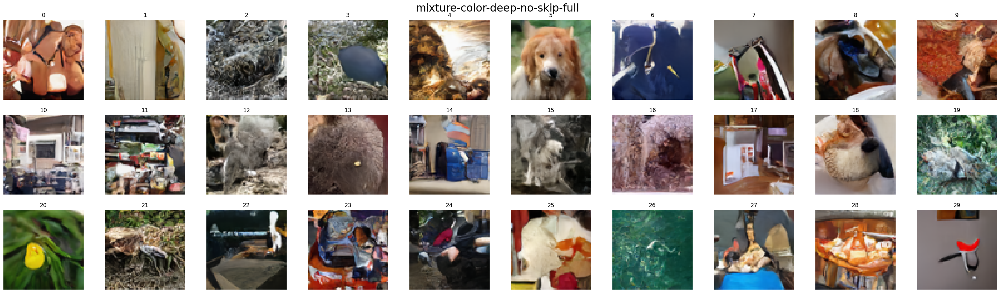

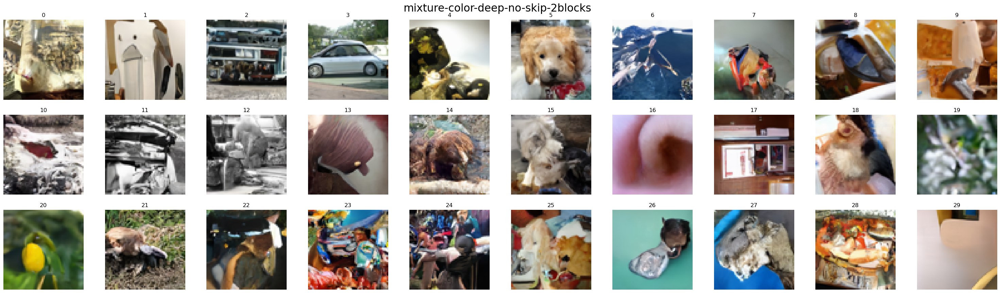

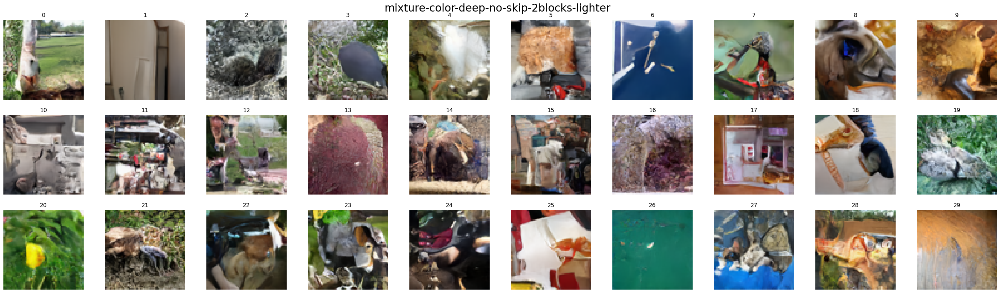

In [29]:
print('fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in groups: 
    show_im_set(all_samples[group], n_columns=10, label=group)

In [73]:

sample_phis = {}
idx = {}

for group in groups:
    sample_phis[group] = {}
    idx[group] = {}
    for sig in sigmas:
        sample_phis[group][sig] = get_activation_means_unconditional(denoisers[group], all_samples[group] + sig/255 * torch.randn_like(all_samples[group]) )
        idx[group][sig] = similarity_matrix_2mats(sample_phis[group][sig][int(len(sample_phis[group][sig])/2)].cpu(), torch.cat(phis[group][sig])).topk(10, dim = 1)[1]
            



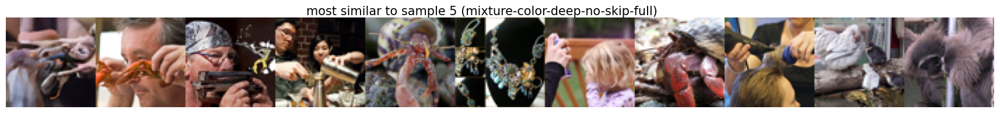

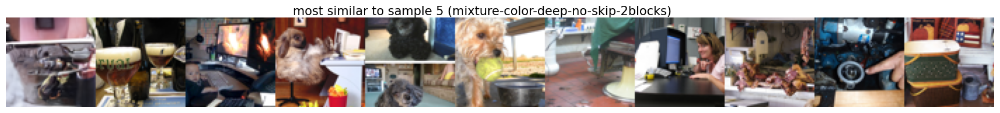

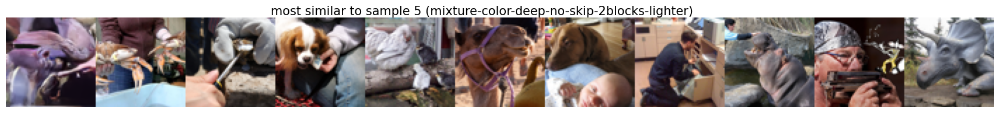

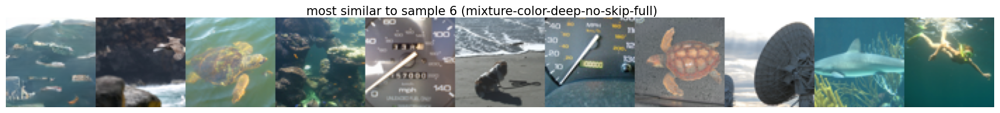

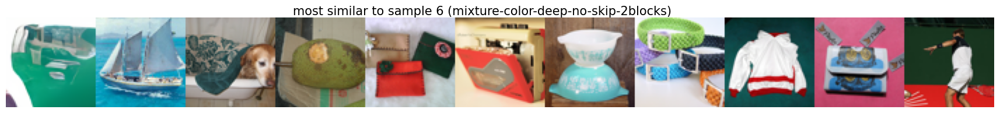

...

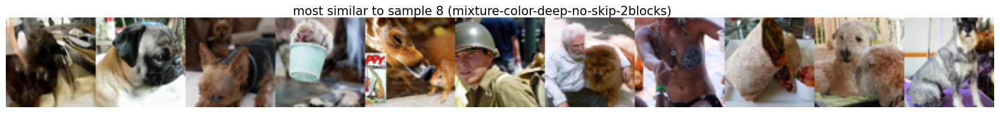

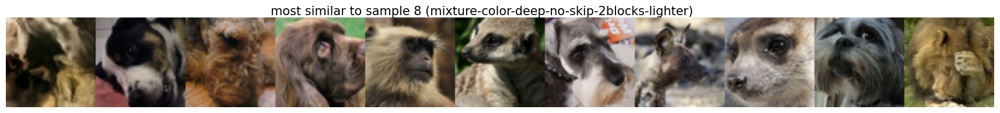

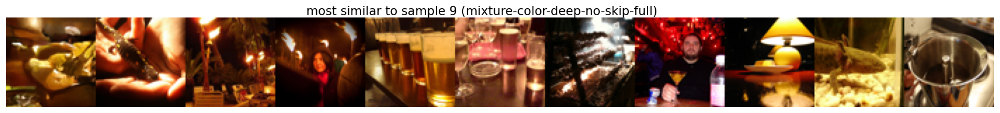

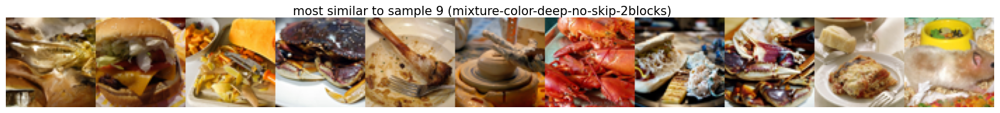

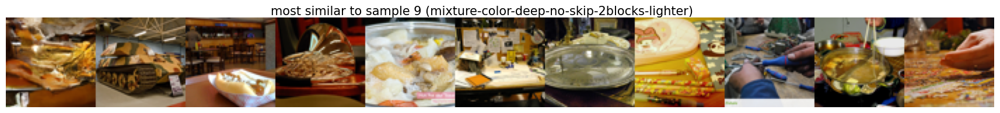

In [44]:
sig = 50
for im_n in range(5,10):
    for group in groups:
        show_im_grid( torch.clip(torch.cat([all_samples[group].cpu()[im_n:im_n+1], test_sets_cat[idx[group][sig][im_n] ] ]) ,0,1), 
             label='most similar to sample '+ str(im_n) + ' ('+group+') ' , 
            n_columns= 11,   font_size=10)


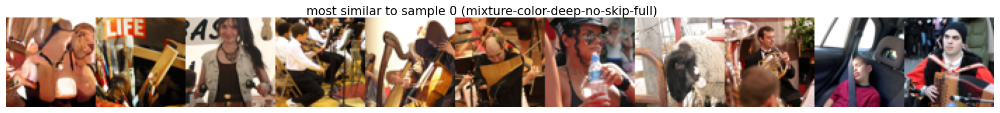

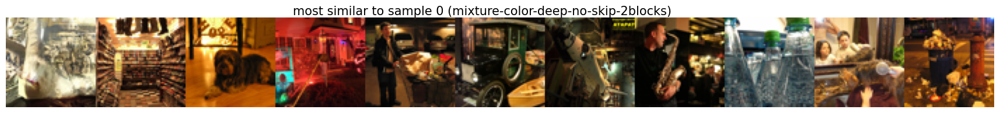

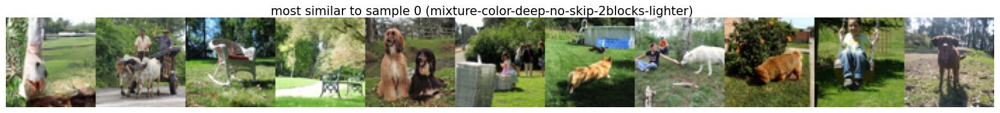

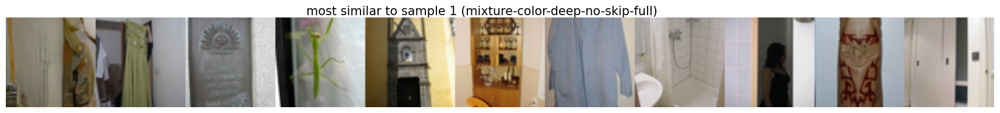

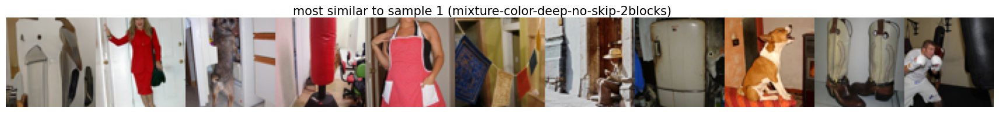

...

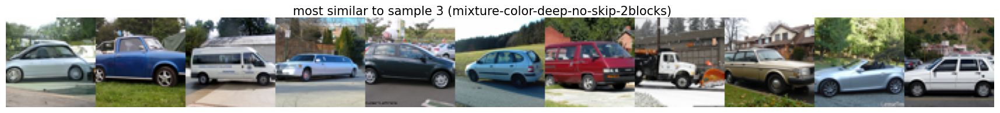

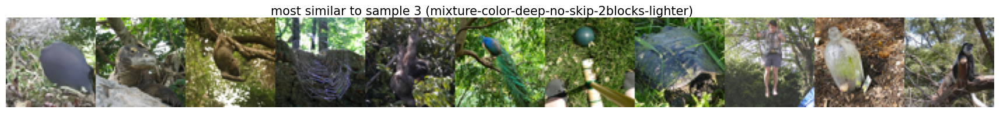

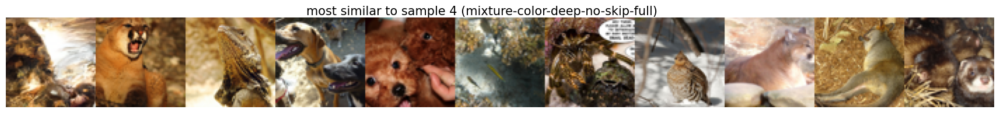

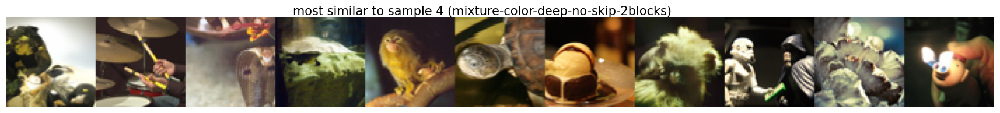

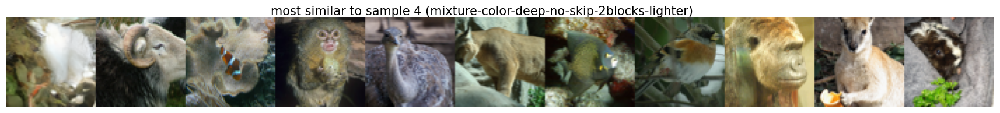

In [30]:
sig = 50
for im_n in range(0,5):
    for group in groups:
        show_im_grid( torch.clip(torch.cat([all_samples[group].cpu()[im_n:im_n+1], test_sets_cat[idx[group][sig][im_n] ] ]) ,0,1), 
             label='most similar to sample '+ str(im_n) + ' ('+group+') ' , 
            n_columns= 11,   font_size=10)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


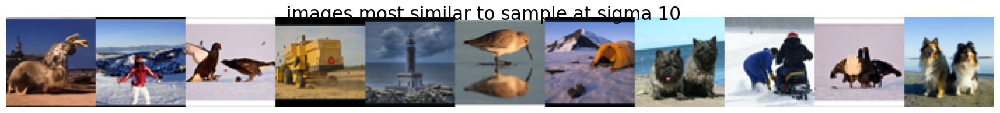

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


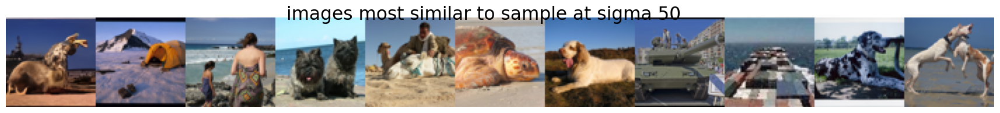

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


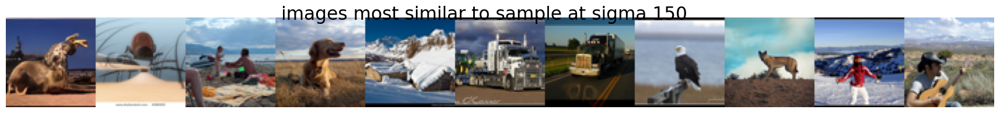

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


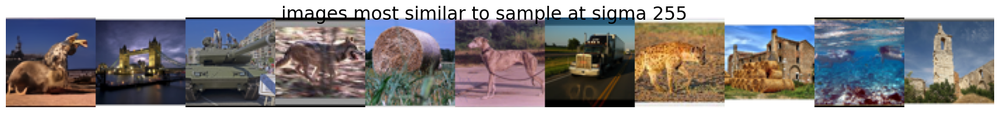

In [113]:
group = 'mixture-color-deep-no-skip-2blocks'

im_n = 2
for sig in sigmas[1::]:
    show_im_grid( torch.cat([all_samples[group].cpu()[im_n:im_n+1], test_sets_cat[idx[group][sig][im_n] ] ]) , 
             label='images most similar to sample at sigma '+ str(sig), 
            n_columns= 11)

In [112]:
my_sigs = torch.hstack(sigs).squeeze()[im_n,:][0::freq].to(device)
noise_normal = torch.randn(my_sigs.shape[0] ,n_channels,K,K ).to(device)
noise = my_sigs.reshape(my_sigs.shape[0], 1,1,1) * noise_normal
noisy_inp = torch.tile(all_samples[group][im_n:im_n+1], (my_sigs.shape[0],1,1,1) )+ noise
print(noisy_inp.shape)
my_sample_phis = get_activation_means_unconditional(denoisers[group],noisy_inp )[int(len(layers[group])/2)]
my_sample_phis.shape


torch.Size([123, 3, 64, 64])


torch.Size([123, 512])

In [111]:
similarity_vactor(my_sample_phis[30] , phis[group] )

torch.Size([123, 512])

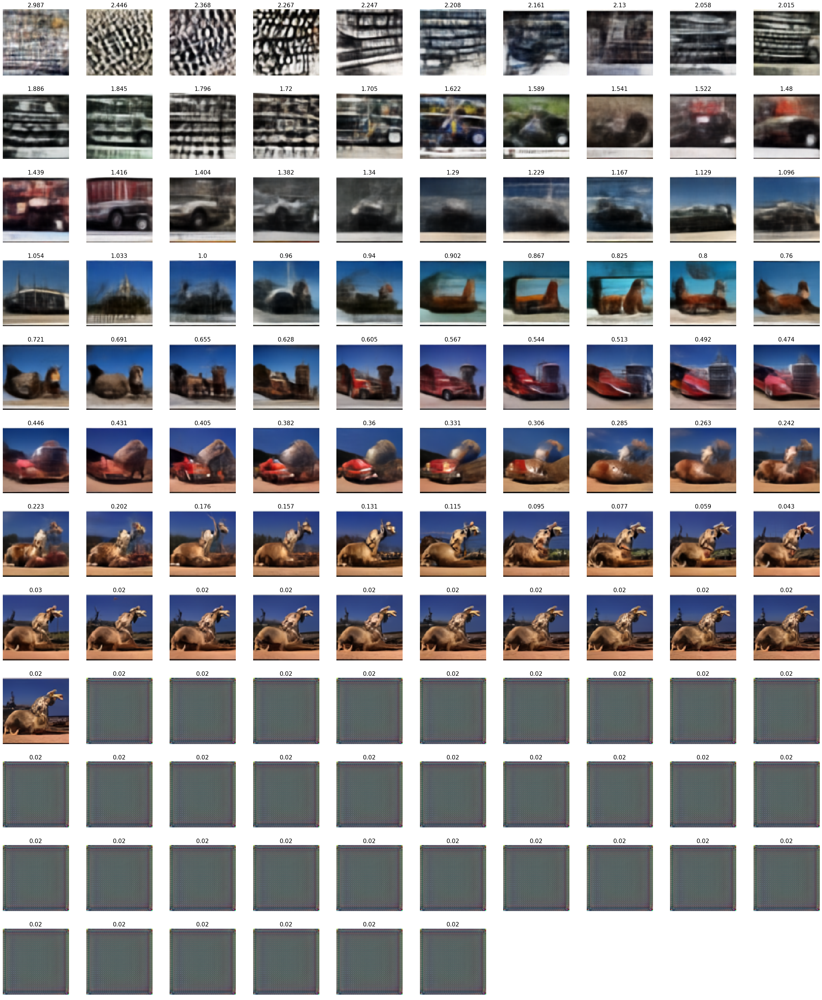

In [66]:
group = 'mixture-color-deep-no-skip-2blocks'

show_im_set(traj_projections(torch.stack(all_interm_Ys[group])[:,im_n], denoisers[group], skip=False )[0::1], 
           sub_labels=np.round(torch.hstack(sigs).squeeze()[im_n,:][0::freq].cpu().numpy() ,3) )

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


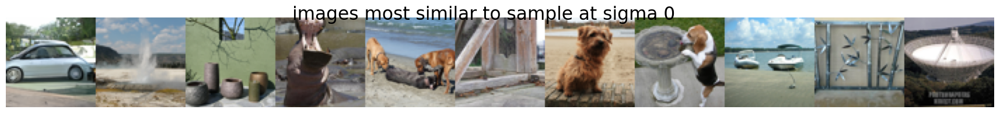

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


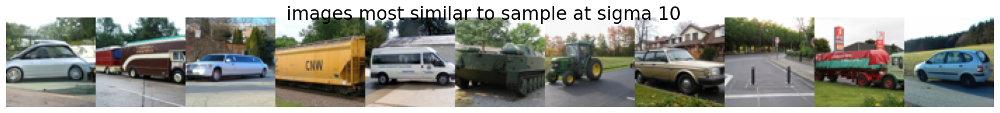

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


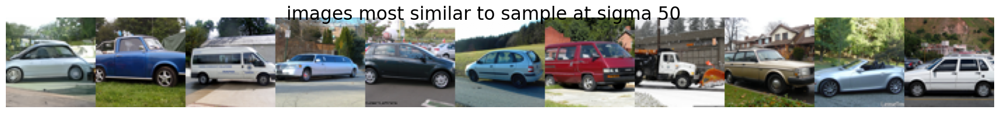

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


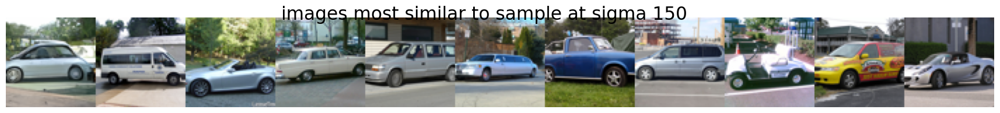

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


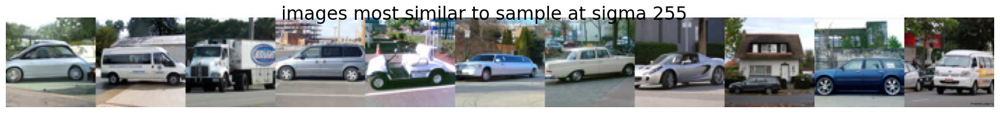

In [31]:
group = 'mixture-color-deep-no-skip-2blocks'

im_n = 3
for sig in sigmas:
    show_im_grid( torch.cat([all_samples[group].cpu()[im_n:im_n+1], test_sets_cat[idx[group][sig][im_n] ] ]) , 
             label='images most similar to sample at sigma '+ str(sig), 
            n_columns= 11)

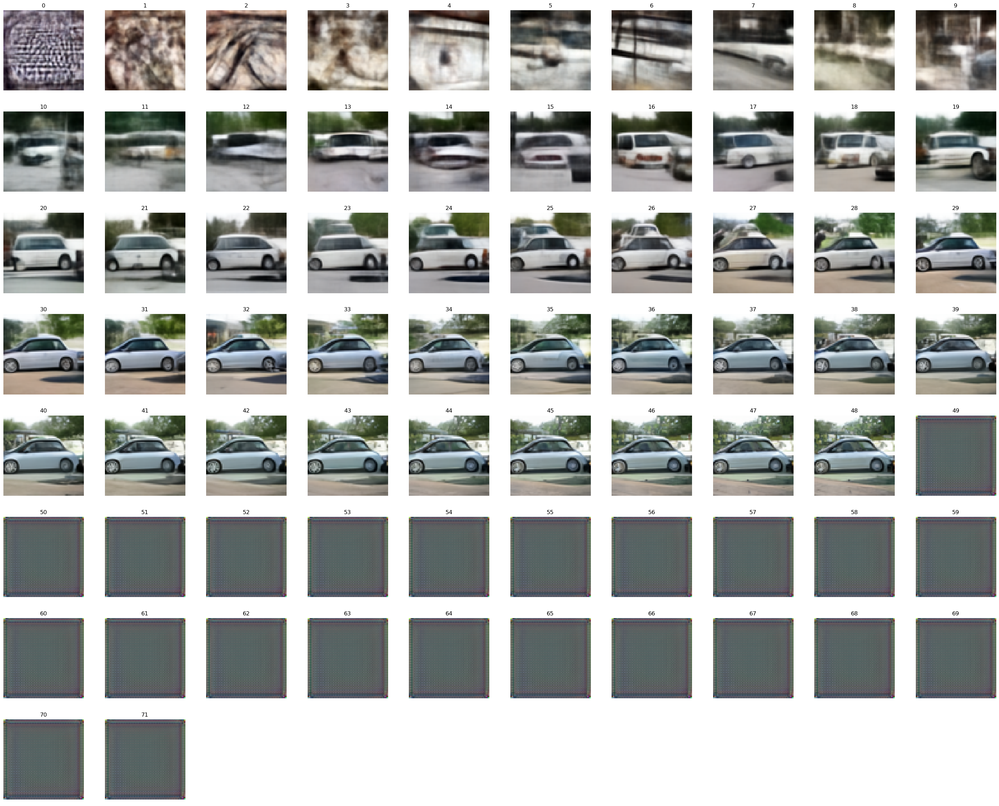

In [32]:
group = 'mixture-color-deep-no-skip-2blocks'

show_im_set(traj_projections(torch.stack(all_interm_Ys[group])[:,im_n], denoisers[group], skip=False )[0::1])

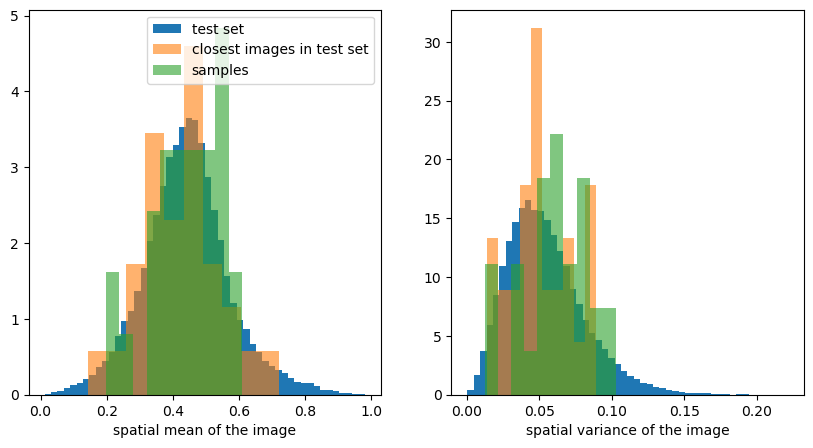

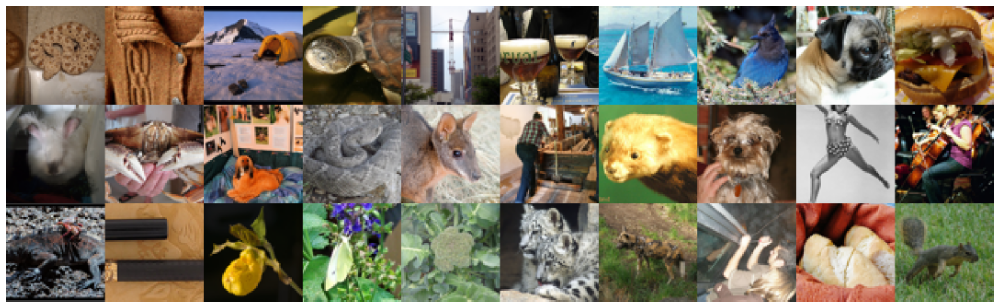

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


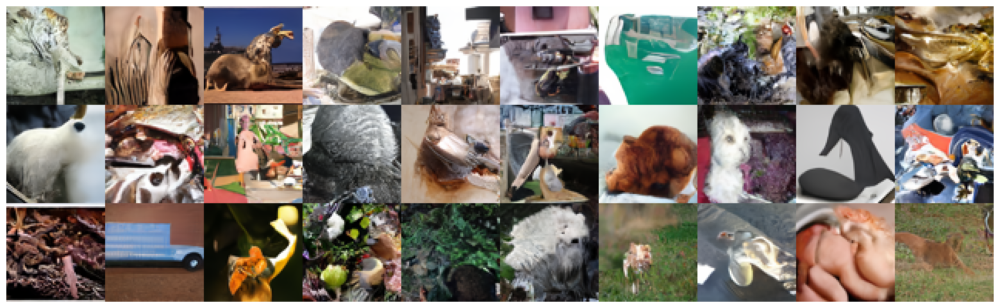

In [51]:
group = 'mixture-color-deep-no-skip-2blocks'


idx = similarity_matrix_2mats(sample_phis[group][sig][int(len(layers[group])/2)].cpu(), torch.cat(phis[group][sig])).topk(1, dim = 1)[1].flatten()


f, axs = plt.subplots(1, 2, figsize = ( 2*5,5 ) , sharey=False)

axs[0].hist(test_sets_cat.mean(dim = (1,2,3))   , bins= 50 , label = 'test set ', density = True);
axs[0].hist(test_sets_cat[idx].cpu().mean(dim = (1,2,3)), bins= 10 , 
         label = 'closest images in test set', density = True, alpha = .6);
axs[0].hist(all_samples[group].cpu().mean(dim = (1,2,3)), bins= 10 , 
         label = 'samples', density = True, alpha = .6);
axs[0].legend()
axs[0].set_xlabel('spatial mean of the image');

axs[1].hist(test_sets_cat.var(dim = (1,2,3))   , bins= 50 , label = 'test set ', density = True);
axs[1].hist(test_sets_cat[idx].cpu().var(dim = (1,2,3)), bins= 10 , 
         label = 'closest images in test set', density = True, alpha = .6);
axs[1].hist(all_samples[group].cpu().var(dim = (1,2,3)), bins= 10 , 
         label = 'samples', density = True, alpha = .6);
axs[1].set_xlabel('spatial variance of the image');

# axs[1].legend();
show_im_grid(test_sets_cat[idx])
show_im_grid(all_samples[group] )


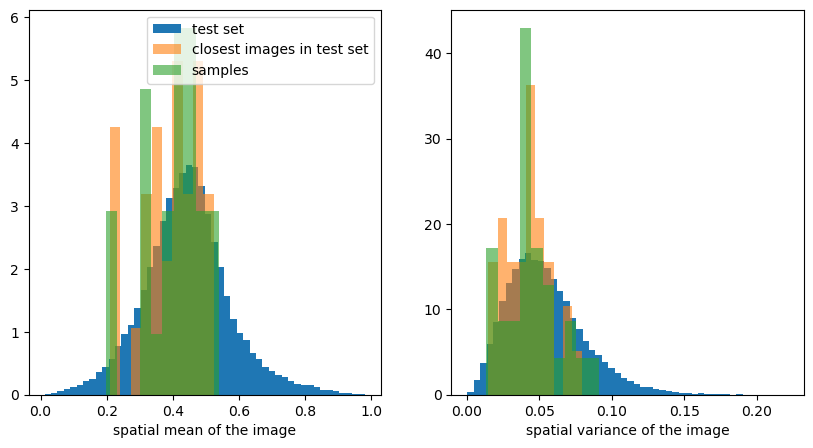

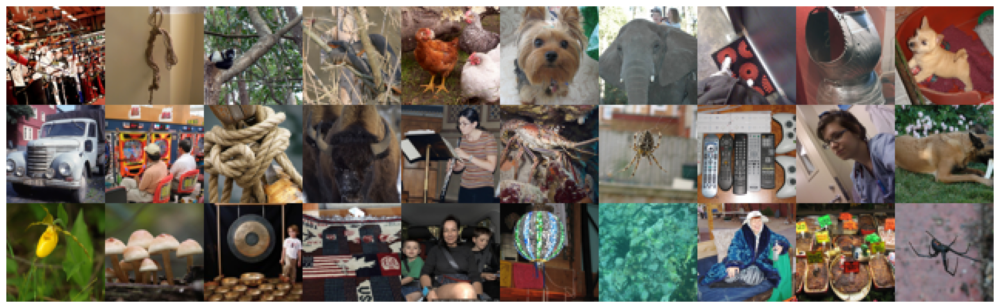

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


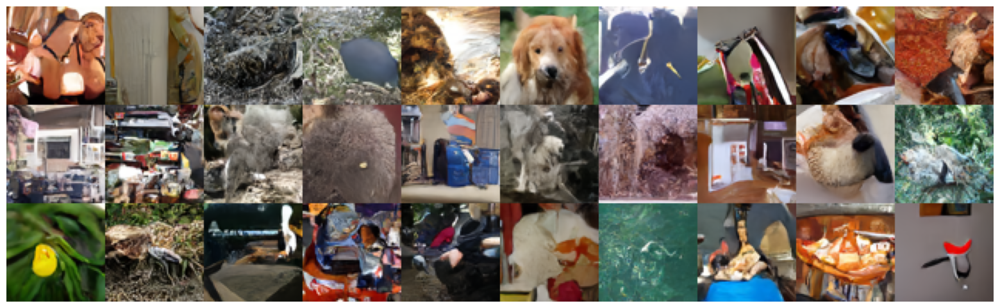

In [45]:
group = 'mixture-color-deep-no-skip-full'


idx = similarity_matrix_2mats(sample_phis[group][sig][int(len(layers[group])/2)].cpu(), torch.cat(phis[group][sig])).topk(1, dim = 1)[1].flatten()


f, axs = plt.subplots(1, 2, figsize = ( 2*5,5 ) , sharey=False)

axs[0].hist(test_sets_cat.mean(dim = (1,2,3))   , bins= 50 , label = 'test set ', density = True);
axs[0].hist(test_sets_cat[idx].cpu().mean(dim = (1,2,3)), bins= 10 , 
         label = 'closest images in test set', density = True, alpha = .6);
axs[0].hist(all_samples[group].cpu().mean(dim = (1,2,3)), bins= 10 , 
         label = 'samples', density = True, alpha = .6);
axs[0].legend()
axs[0].set_xlabel('spatial mean of the image');

axs[1].hist(test_sets_cat.var(dim = (1,2,3))   , bins= 50 , label = 'test set ', density = True);
axs[1].hist(test_sets_cat[idx].cpu().var(dim = (1,2,3)), bins= 10 , 
         label = 'closest images in test set', density = True, alpha = .6);
axs[1].hist(all_samples[group].cpu().var(dim = (1,2,3)), bins= 10 , 
         label = 'samples', density = True, alpha = .6);
axs[1].set_xlabel('spatial variance of the image');

# axs[1].legend();
show_im_grid(test_sets_cat[idx])
show_im_grid(all_samples[group] )


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


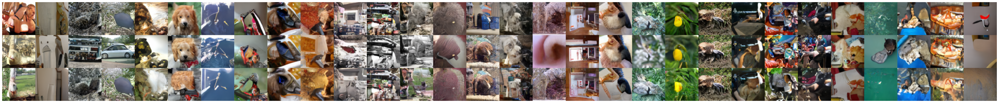

In [46]:
show_im_grid(torch.vstack([all_samples[group] for group in groups  ] ), n_columns=30)


Text(0.5, 0, 'iter')

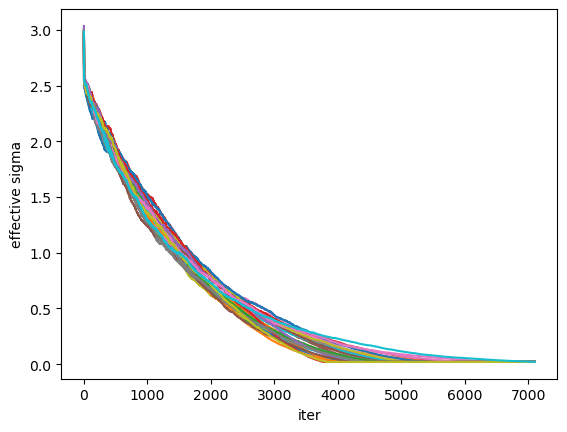

In [94]:
for i in range(len(all_samples[group])):
    plt.plot(torch.hstack(sigs).squeeze()[i,:].cpu())
plt.ylabel('effective sigma')
plt.xlabel('iter')

Text(0.5, 0, 'iter')

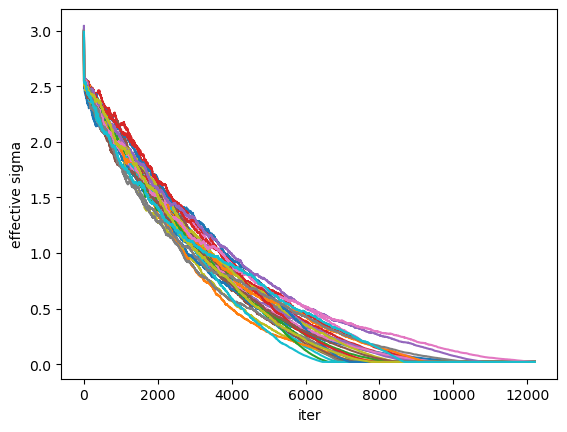

In [46]:
for i in range(len(all_samples[group])):
    plt.plot(torch.hstack(sigs).squeeze()[i,:].cpu())
plt.ylabel('effective sigma')
plt.xlabel('iter')

Text(0.5, 0, 'iter')

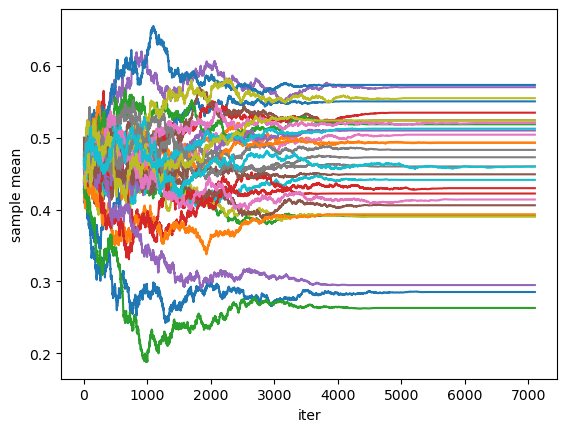

In [103]:

for i in range(len(all_samples[group])):
    plt.plot(torch.stack(means).mean(dim = 2)[:,i].cpu())
plt.ylabel('sample mean')
plt.xlabel('iter')

Text(0.5, 0, 'iter')

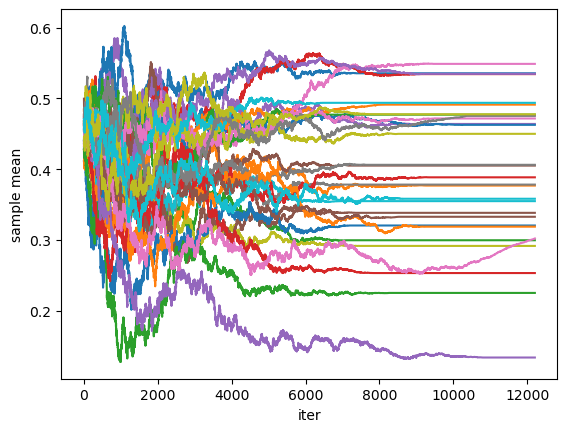

In [47]:

for i in range(len(all_samples[group])):
    plt.plot(torch.stack(means).mean(dim = 2)[:,i].cpu())
plt.ylabel('sample mean')
plt.xlabel('iter')

mixture-color-deep-no-skip-full fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.02  seed= 1


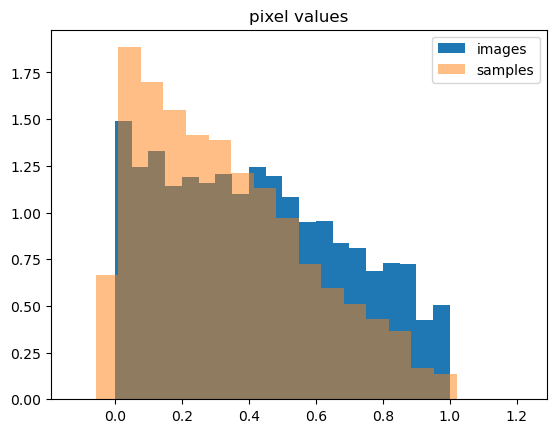

In [48]:
group = 'mixture-color-deep-no-skip-full'

plt.hist(test_sets_cat[1::1000].flatten(), bins = 20, label='images', density= True )
plt.hist(all_samples[group].cpu().flatten(), bins = 20, alpha = .5, label = 'samples', density=True)
plt.title('pixel values')
plt.legend();
print(group, 'fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)


mixture-color-deep-no-skip-full fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.05  seed= 1


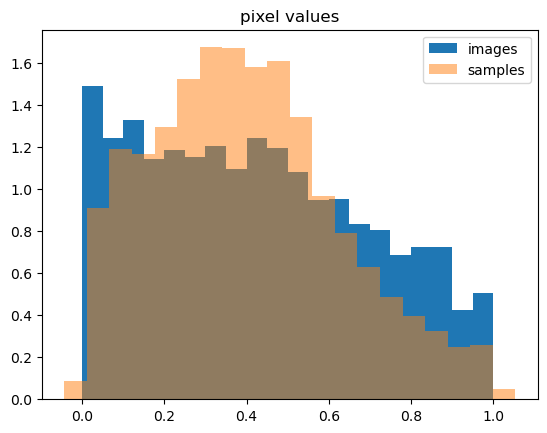

In [37]:
group = 'mixture-color-deep-no-skip-full'

plt.hist(test_sets_cat[1::1000].flatten(), bins = 20, label='images', density= True )
plt.hist(all_samples[group].cpu().flatten(), bins = 20, alpha = .5, label = 'samples', density=True)
plt.title('pixel values')
plt.legend();
print(group, 'fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)


mixture-color-deep-no-skip-2blocks fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.02  seed= 1


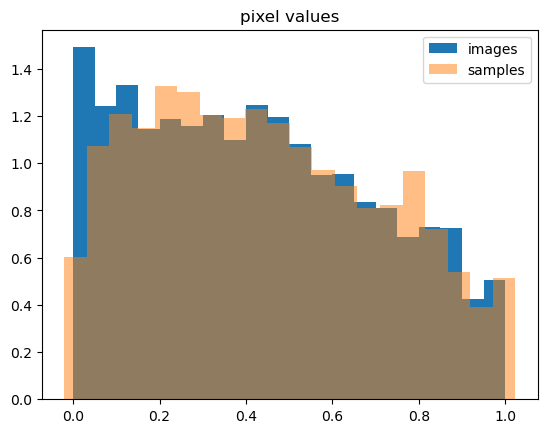

In [49]:
group = 'mixture-color-deep-no-skip-2blocks'

plt.hist(test_sets_cat[1::1000].flatten(), bins = 20, label='images', density= True )
plt.hist(all_samples[group].cpu().flatten(), bins = 20, alpha = .5, label = 'samples', density=True)
plt.title('pixel values')
plt.legend();
print(group, 'fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)


mixture-color-deep-no-skip-2blocks fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.05  seed= 1


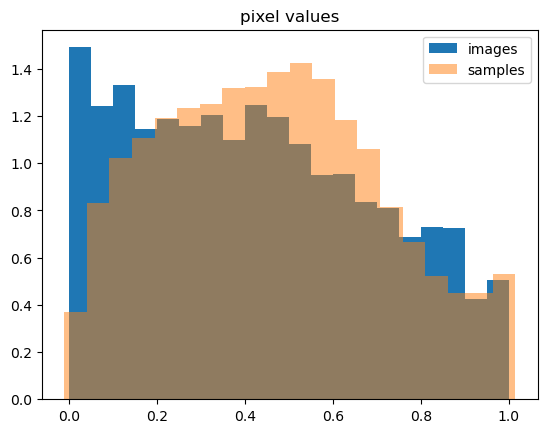

In [38]:
group = 'mixture-color-deep-no-skip-2blocks'

plt.hist(test_sets_cat[1::1000].flatten(), bins = 20, label='images', density= True )
plt.hist(all_samples[group].cpu().flatten(), bins = 20, alpha = .5, label = 'samples', density=True)
plt.title('pixel values')
plt.legend();
print(group, 'fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)


mixture-color-deep-no-skip-2blocks-lighter fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.02  seed= 1


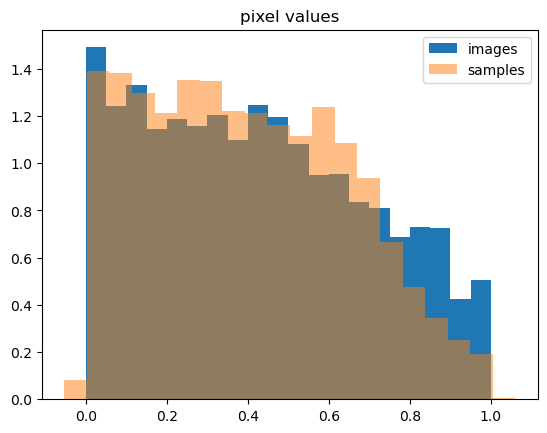

In [50]:
group = 'mixture-color-deep-no-skip-2blocks-lighter'

plt.hist(test_sets_cat[1::1000].flatten(), bins = 20, label='images', density= True )
plt.hist(all_samples[group].cpu().flatten(), bins = 20, alpha = .5, label = 'samples', density=True)
plt.title('pixel values')
plt.legend();
print(group, 'fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)


mixture-color-deep-no-skip-2blocks-lighter fixed_h= True  sig_L=  0.02  h0= 0.01  beta= 0.05  seed= 1


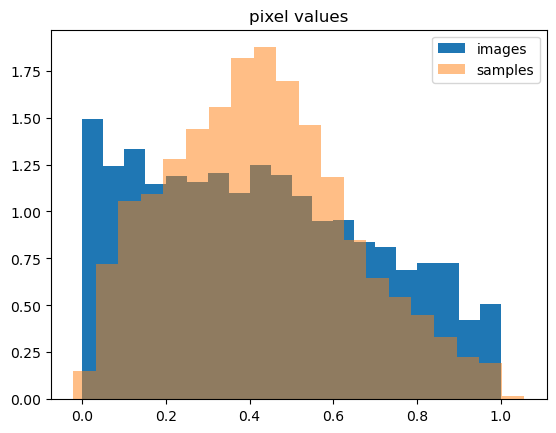

In [39]:
group = 'mixture-color-deep-no-skip-2blocks-lighter'

plt.hist(test_sets_cat[1::1000].flatten(), bins = 20, label='images', density= True )
plt.hist(all_samples[group].cpu().flatten(), bins = 20, alpha = .5, label = 'samples', density=True)
plt.title('pixel values')
plt.legend();
print(group, 'fixed_h=', fixed_h, ' sig_L= ',sig_L, ' h0=', h0, ' beta=',beta, ' seed=', seed)


## Are the specialized channels off for the sample's $\phi$s? 

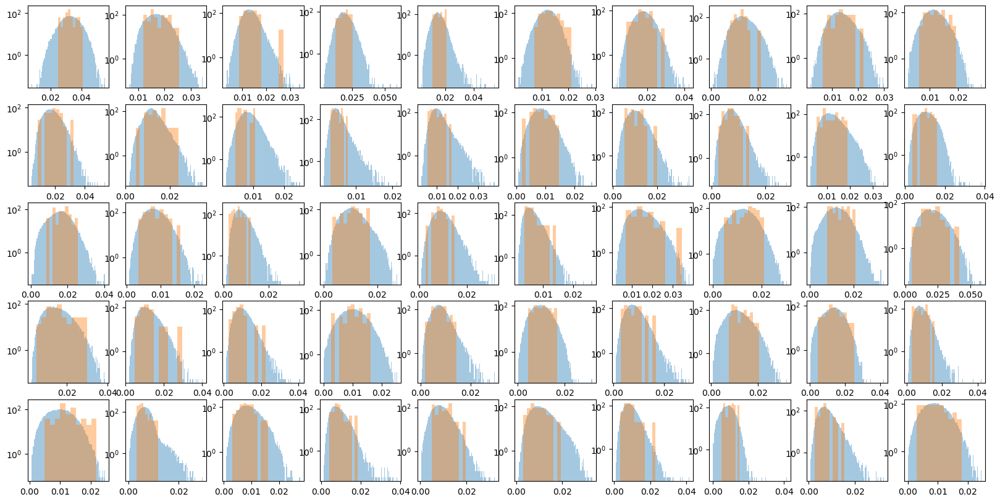

In [47]:
group = 'mixture-color-deep-no-skip-full'
mid_b = int(len(layers[group])/2)

sample_phis = get_activation_means_unconditional(denoisers[group], all_samples[group] + sig/255 * torch.randn_like(all_samples[group]) )


f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(0, 50): 
    axs[i].hist(torch.cat(phis[group][sig])[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( sample_phis[mid_b].cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], alpha = .4, density = True);
    axs[i].set_yscale('log')
    i += 1

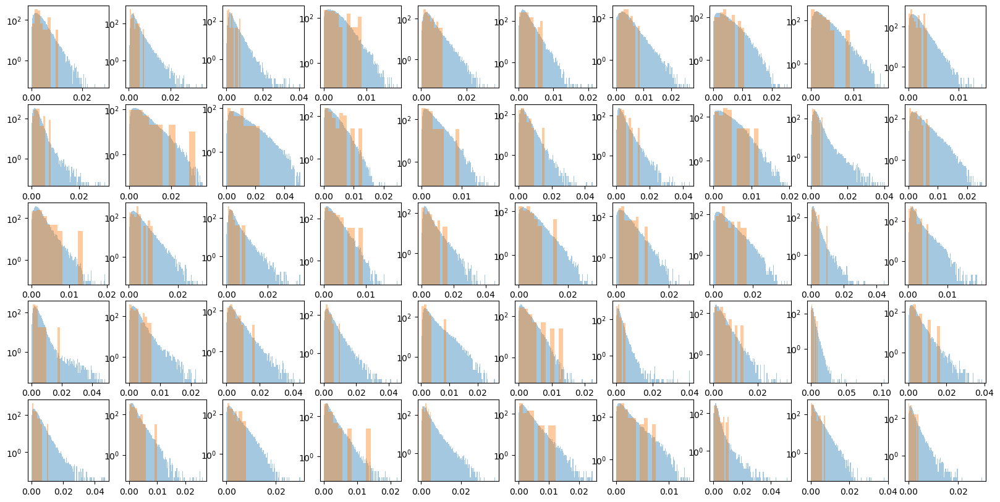

In [48]:

f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(250, 300): 
    axs[i].hist(torch.cat(phis[group][sig])[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], density = True,  alpha = .4, bins = 100);
    axs[i].hist( sample_phis[mid_b].cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], alpha = .4, density = True);
    axs[i].set_yscale('log')
    i += 1

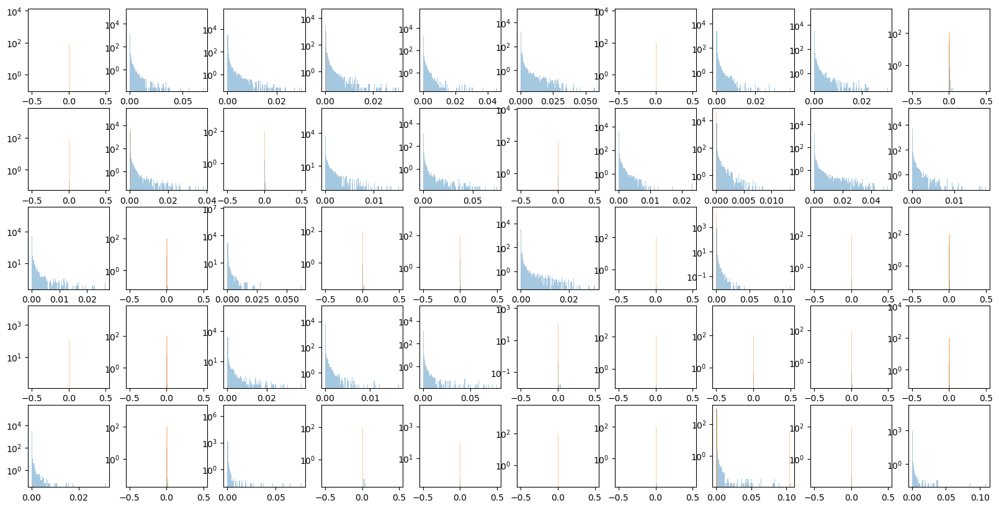

In [49]:
f, axs = plt.subplots(5,10, figsize = (20, 10))
axs = axs.ravel()
i = 0
for ch_n in range(512-50, 512): 
    axs[i].hist(torch.cat(phis[group][255]).cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], density = True,  alpha = .4,
                bins = 100);
    axs[i].hist( sample_phis[mid_b].cpu()[:, ids_selectivity_sorted[group][sig].cpu() ][:,ch_n], alpha = .4, density = True, bins = 100);
    axs[i].set_yscale('log')
    i += 1